In [1]:
%matplotlib inline

import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

In [2]:
path = '../audio_samples/'
group1 = 'group_1/'
group2 = 'group_2/'
file_name1_group1 = 'Blue Swede - Hooked On A Feeling.mp3'
file_name2_group1 = 'Queen - Dont stop me now l.mp3'
file_name3_group2 = 'twenty-one-pilots-nico-and-the-niners.mp3'
path_to_file1 = path + group1 + file_name1_group1  # group 1
path_to_file2 = path + group1 + file_name2_group1  # group 1
path_to_file3 = path + group2 + file_name3_group2  # group 2

In [3]:
def show_cqt(path_to_file):
    x, sr = librosa.load(path_to_file, sr=None, mono=True)
    cqt = np.abs(librosa.cqt(x, sr=sr))
    print(cqt.shape)
    librosa.display.specshow(librosa.amplitude_to_db(cqt, ref=np.max),
                         sr=sr, x_axis='time', y_axis='cqt_note')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Constant-Q power spectrum')
    plt.tight_layout()

In [4]:
def show_chroma_cqt(path_to_file):
    y, sr = librosa.load(path_to_file, sr=None, mono=True)
    cqt = np.abs(librosa.cqt(x, sr=sr))
    chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr,
                                              n_chroma=12, n_fft=4096)
    chroma_cq = librosa.feature.chroma_cqt(C=cqt, sr=sr)
    plt.figure()
    plt.subplot(2,1,1)
    librosa.display.specshow(chroma_stft, y_axis='chroma')
    plt.title('chroma_stft')
    plt.colorbar()
    plt.subplot(2,1,2)
    librosa.display.specshow(chroma_cq, y_axis='chroma', x_axis='time')
    plt.title('chroma_cqt')
    plt.colorbar()
    plt.tight_layout()

In [5]:
def show_chroma_cens(path_to_file):
    plt.figure()
    y, sr = librosa.load(path_to_file, sr=None, mono=True)
    cqt = np.abs(librosa.cqt(y, sr=sr))
    chroma_cens = librosa.feature.chroma_cens(C=cqt, n_chroma=12, n_octaves=7)
    librosa.display.specshow(chroma_cens, y_axis='chroma', x_axis='time')
    plt.colorbar()
    plt.show()

In [6]:
def show_tonnetz(path_to_file):
    plt.figure()
    y, sr = librosa.load(path_to_file, sr=None, mono=True)
    cqt = np.abs(librosa.cqt(y, sr=sr))
    chroma_cens = librosa.feature.chroma_cens(C=cqt, n_chroma=12, n_octaves=7)
    tonnetz = librosa.feature.tonnetz(chroma=chroma_cens)
    librosa.display.specshow(tonnetz, y_axis='chroma', x_axis='time')
    plt.colorbar()
    plt.show()

In [7]:
def show_stft(path_to_file):
    plt.figure()
    y, sr = librosa.load(path_to_file, sr=None, mono=True)
    stft = np.abs(librosa.stft(y, n_fft=2048, hop_length=512))
    librosa.display.specshow(librosa.amplitude_to_db(stft, ref=np.max),
                                                y_axis='log', x_axis='time')
    plt.title('Power spectrogram')
    plt.colorbar(format='%+2.0f dB')
    plt.tight_layout()

In [8]:
def show_rmse(path_to_file):
    plt.figure()
    y, sr = librosa.load(path_to_file, sr=None, mono=True)
    stft = np.abs(librosa.stft(y, n_fft=2048, hop_length=512))
    rms = librosa.feature.rmse(S=stft)
    plt.subplot(2, 1, 1)
    plt.semilogy(rms.T, label='RMS Energy')
    plt.xticks([])
    plt.xlim([0, rms.shape[-1]])
    plt.legend(loc='best')
    plt.subplot(2, 1, 2)
    librosa.display.specshow(librosa.amplitude_to_db(stft, ref=np.max),
                             y_axis='log', x_axis='time')
    plt.title('log Power spectrogram')
    plt.tight_layout()

In [9]:
def show_spectral_centroid(path_to_file):
    plt.figure()
    y, sr = librosa.load(path_to_file, sr=None, mono=True)
    stft = np.abs(librosa.stft(y, n_fft=2048, hop_length=512))
    cent = librosa.feature.spectral_centroid(S=stft)
    plt.subplot(2, 1, 1)
    plt.semilogy(cent.T, label='Spectral centroid')
    plt.ylabel('Hz')
    plt.xticks([])
    plt.xlim([0, cent.shape[-1]])
    plt.legend()
    plt.subplot(2, 1, 2)
    librosa.display.specshow(librosa.amplitude_to_db(stft, ref=np.max),
                             y_axis='log', x_axis='time')
    plt.title('log Power spectrogram')
    plt.tight_layout()

In [10]:
def show_spectral_bandwidth(path_to_file):
    plt.figure()
    y, sr = librosa.load(path_to_file, sr=None, mono=True)
    stft = np.abs(librosa.stft(y, n_fft=2048, hop_length=512))
    spec_bw = librosa.feature.spectral_bandwidth(S=stft)
    plt.subplot(2, 1, 1)
    plt.semilogy(spec_bw.T, label='Spectral bandwidth')
    plt.ylabel('Hz')
    plt.xticks([])
    plt.xlim([0, spec_bw.shape[-1]])
    plt.legend()
    plt.subplot(2, 1, 2)
    librosa.display.specshow(librosa.amplitude_to_db(stft, ref=np.max),
                             y_axis='log', x_axis='time')
    plt.title('log Power spectrogram')
    plt.tight_layout()

In [11]:
def show_spectral_contrast(path_to_file):
    plt.figure()
    y, sr = librosa.load(path_to_file, sr=None, mono=True)
    stft = np.abs(librosa.stft(y, n_fft=2048, hop_length=512))
    contrast = librosa.feature.spectral_contrast(S=stft)
    librosa.display.specshow(contrast, x_axis='time')
    plt.colorbar()
    plt.ylabel('Frequency bands')
    plt.title('Spectral contrast')
    plt.tight_layout()

In [12]:
def show_spectral_rollof(path_to_file):
    plt.figure()
    y, sr = librosa.load(path_to_file, sr=None, mono=True)
    stft = np.abs(librosa.stft(y, n_fft=2048, hop_length=512))
    rolloff = librosa.feature.spectral_rolloff(S=stft)
    plt.subplot(2, 1, 1)
    plt.semilogy(rolloff.T, label='Roll-off frequency')
    plt.ylabel('Hz')
    plt.xticks([])
    plt.xlim([0, rolloff.shape[-1]])
    plt.legend()
    plt.subplot(2, 1, 2)
    librosa.display.specshow(librosa.amplitude_to_db(stft, ref=np.max),
                             y_axis='log', x_axis='time')
    plt.title('log Power spectrogram')
    plt.tight_layout()

In [13]:
def show_melspectogram(path_to_file):
    plt.figure()
    y, sr = librosa.load(path_to_file, sr=None, mono=True)
    stft = np.abs(librosa.stft(y, n_fft=2048, hop_length=512))**2
    mel = librosa.feature.melspectrogram(sr=sr, S=stft)
    librosa.display.specshow(librosa.power_to_db(stft, ref=np.max),
                            y_axis='mel', fmax=8000, x_axis='time')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Mel spectrogram')
    plt.tight_layout()

In [14]:
def show_mfcc(path_to_file):
    plt.figure()
    y, sr = librosa.load(path_to_file, sr=None, mono=True)
    mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=20)
    librosa.display.specshow(mfcc, x_axis='time')
    plt.colorbar()
    plt.title('MFCC')
    m_slaney = librosa.feature.mfcc(y=y, sr=sr, dct_type=2)
    m_htk = librosa.feature.mfcc(y=y, sr=sr, dct_type=3)
    plt.figure(figsize=(10, 6))
    plt.subplot(2, 1, 1)
    librosa.display.specshow(m_slaney, x_axis='time')
    plt.title('RASTAMAT / Auditory toolbox (dct_type=2)')
    plt.colorbar()
    plt.subplot(2, 1, 2)
    librosa.display.specshow(m_htk, x_axis='time')
    plt.title('HTK-style (dct_type=3)')
    plt.colorbar()
    plt.tight_layout()          

(84, 14890)


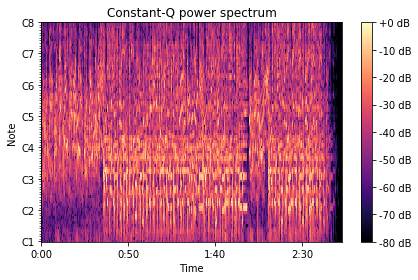

In [15]:
plt.figure(0)
show_cqt(path_to_file1)

(84, 18448)


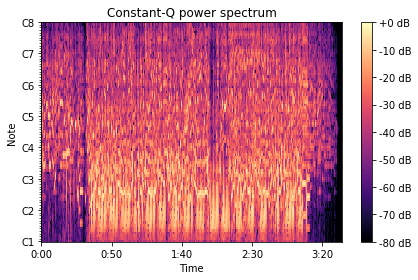

In [16]:
plt.figure(1)
show_cqt(path_to_file2)

(84, 19587)


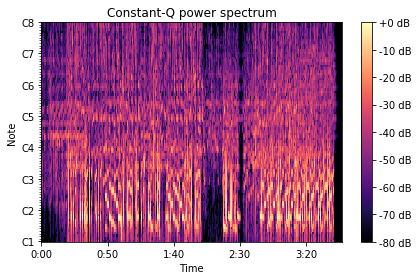

In [17]:
plt.figure(2)
show_cqt(path_to_file3)

In [18]:
show_chroma_cqt(path_to_file1)

NameError: name 'x' is not defined

In [19]:
show_chroma_cqt(path_to_file3)

NameError: name 'x' is not defined

In [20]:
show_chroma_cqt(path_to_file2)

NameError: name 'x' is not defined

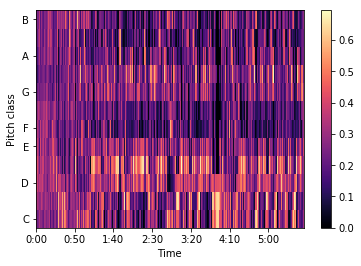

In [21]:
show_chroma_cens(path_to_file1)

In [ ]:
show_chroma_cens(path_to_file2)

In [ ]:
show_chroma_cens(path_to_file3)

In [ ]:
show_tonnetz(path_to_file1)

In [ ]:
show_tonnetz(path_to_file2)

<IPython.core.display.Javascript object>


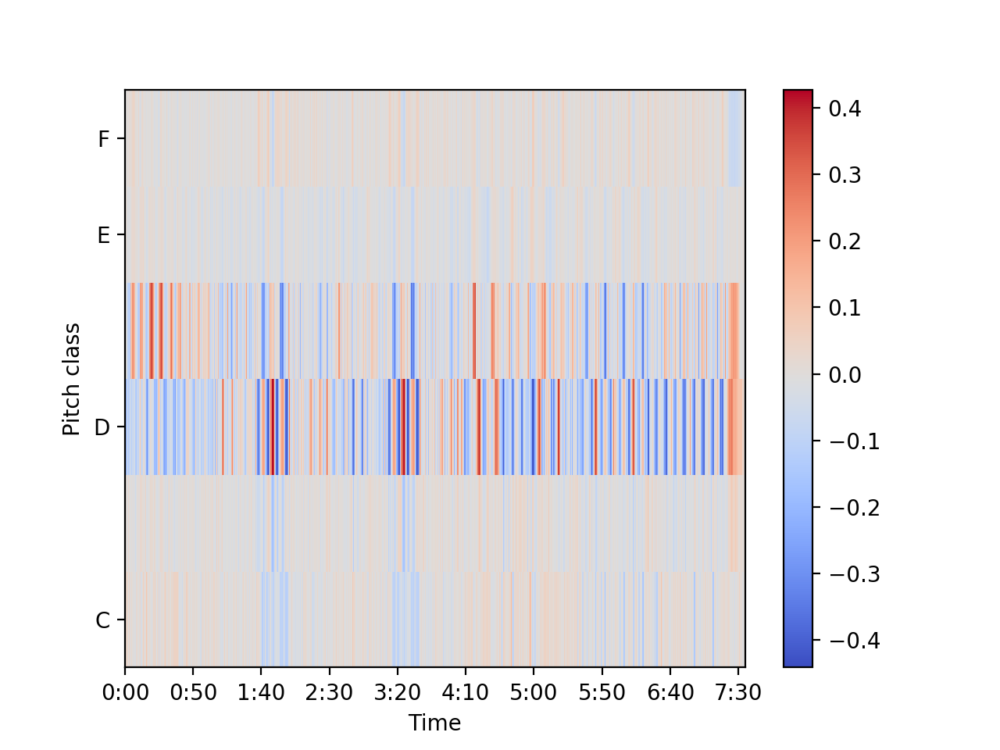

In [74]:
show_tonnetz(path_to_file3)

<IPython.core.display.Javascript object>


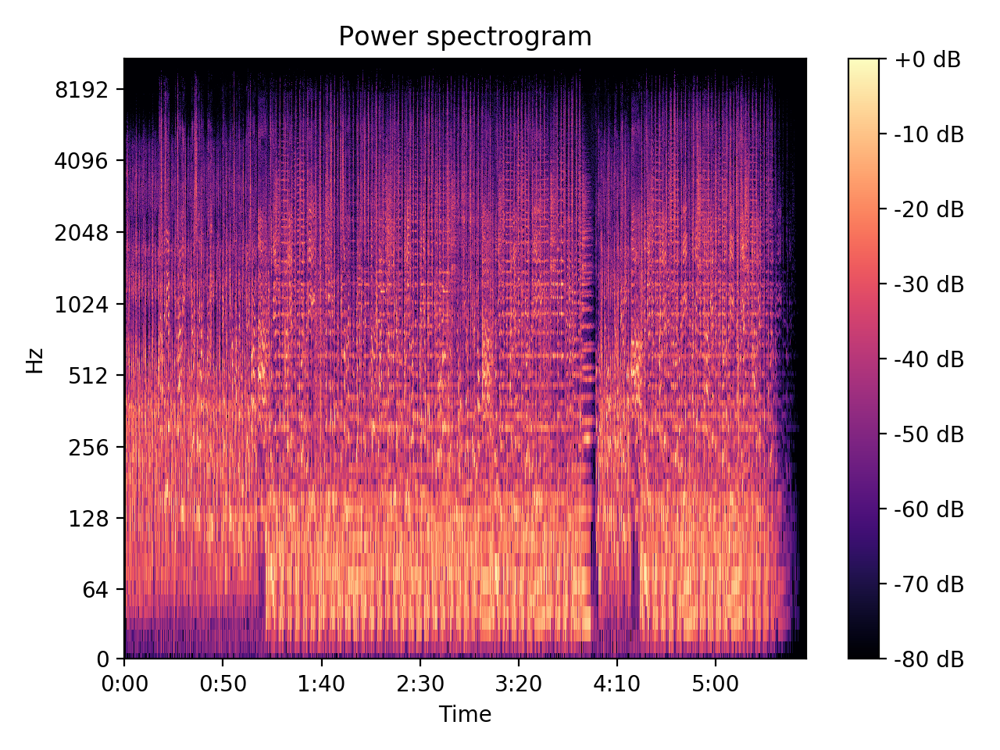

In [76]:
show_stft(path_to_file1)

<IPython.core.display.Javascript object>


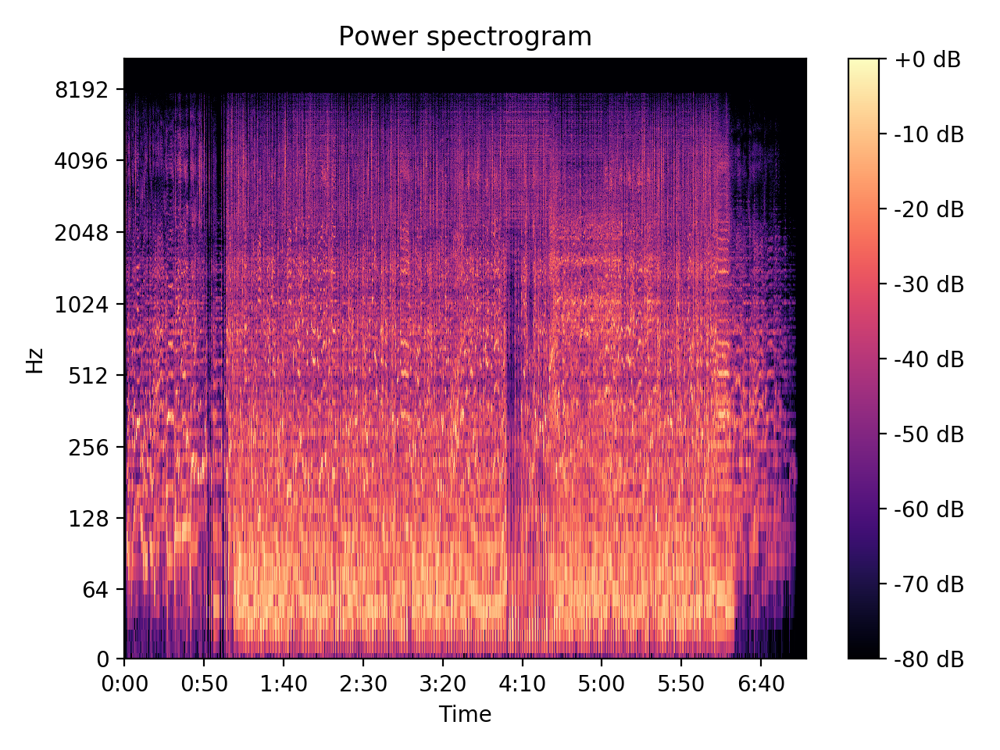

In [77]:
show_stft(path_to_file2)

<IPython.core.display.Javascript object>


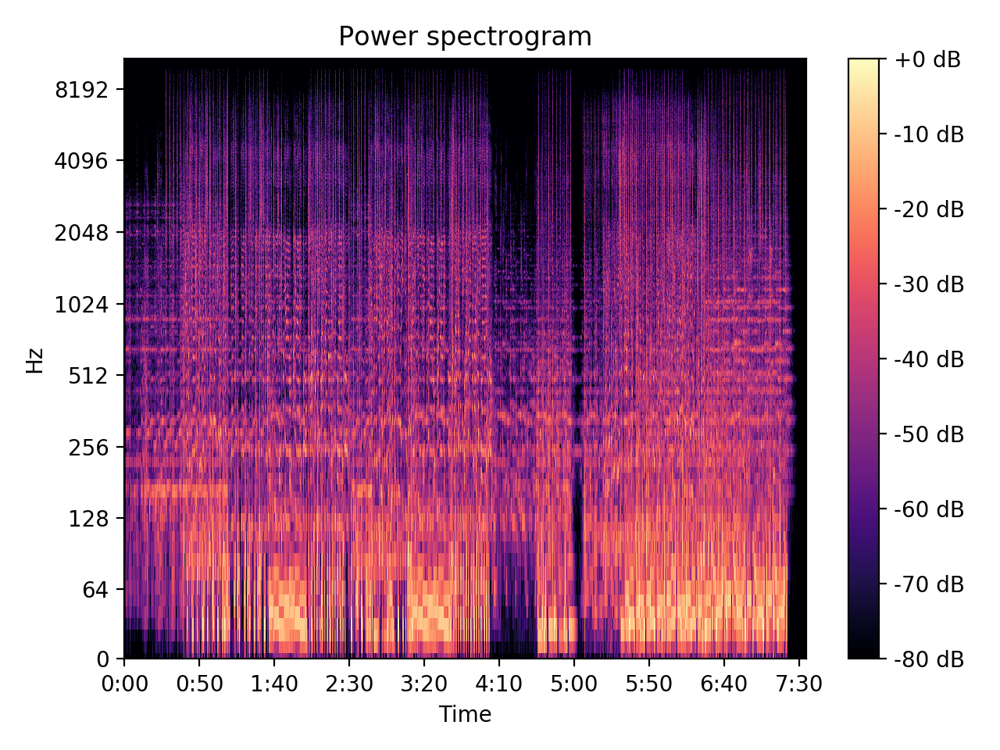

In [78]:
show_stft(path_to_file3)

<IPython.core.display.Javascript object>


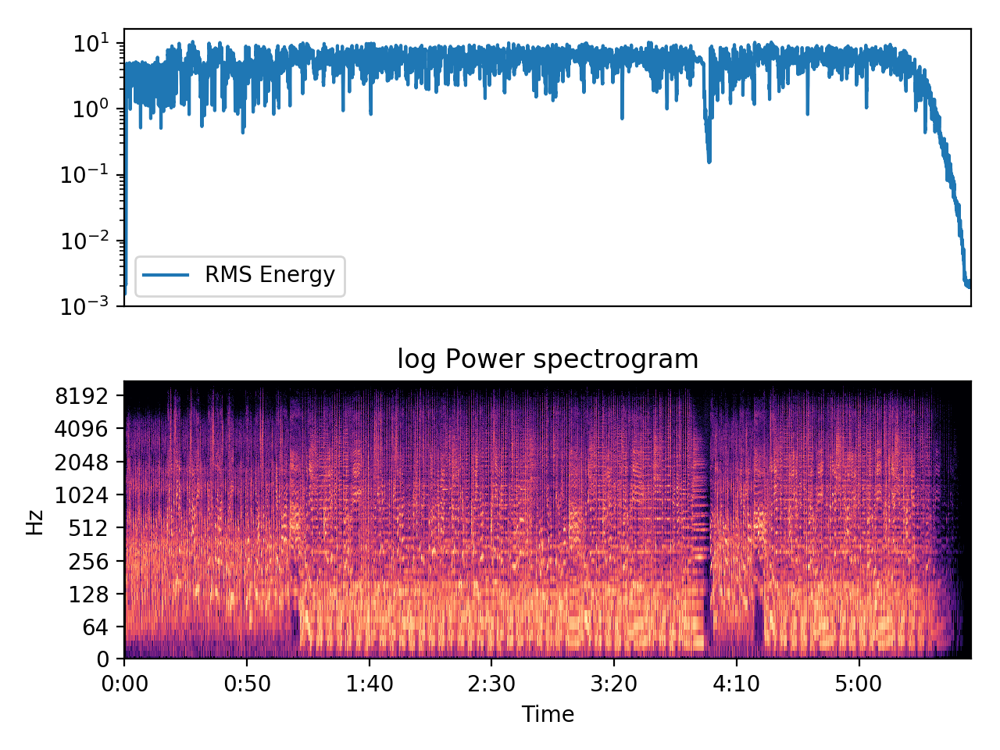

In [80]:
show_rmse(path_to_file1)

<IPython.core.display.Javascript object>


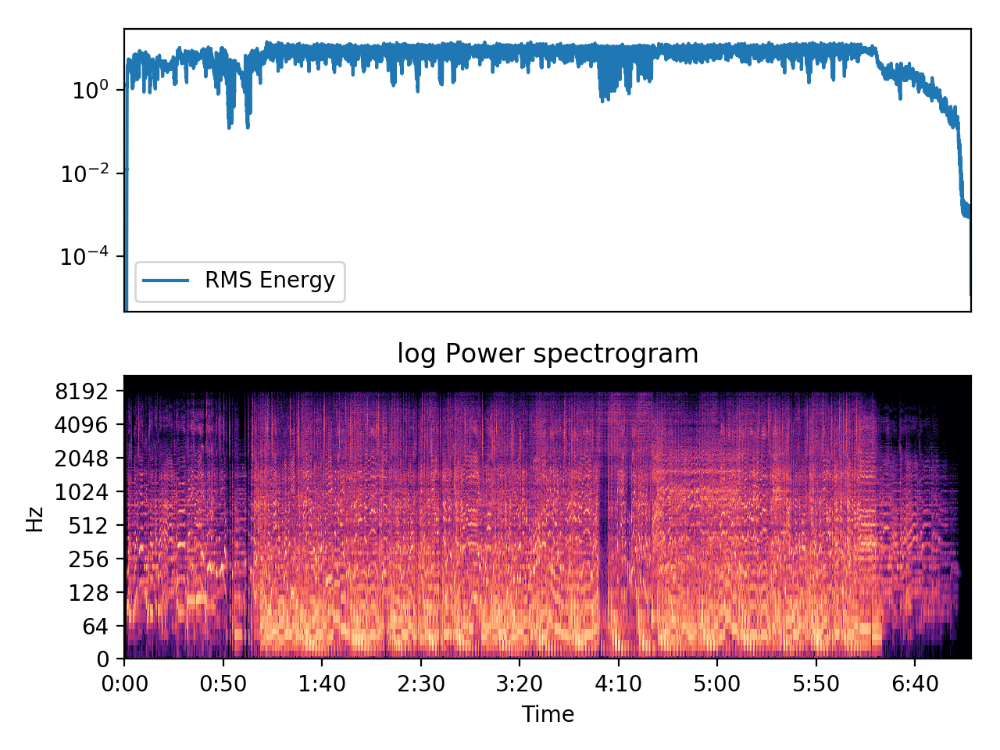

In [81]:
show_rmse(path_to_file2)

<IPython.core.display.Javascript object>


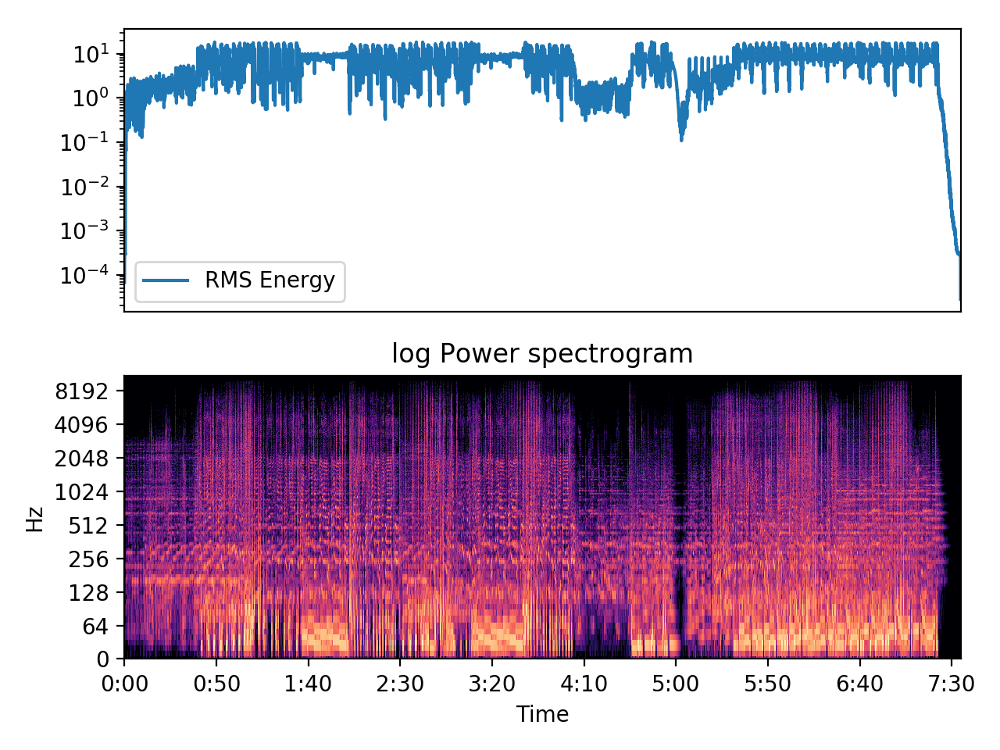

In [82]:
show_rmse(path_to_file3)

<IPython.core.display.Javascript object>


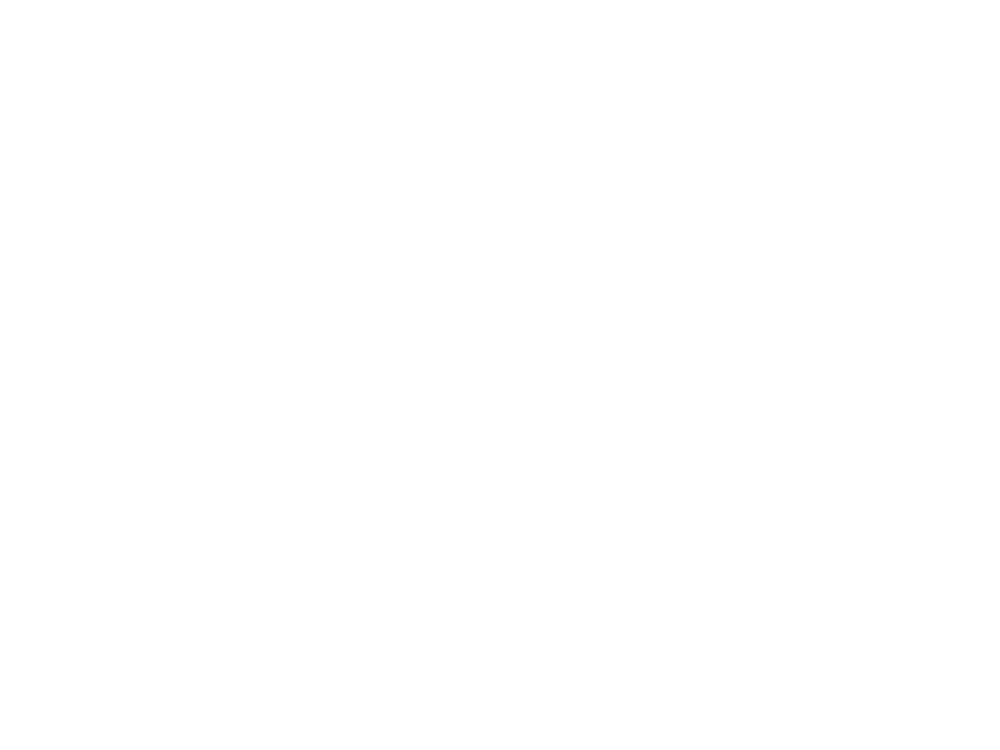

<IPython.core.display.Javascript object>


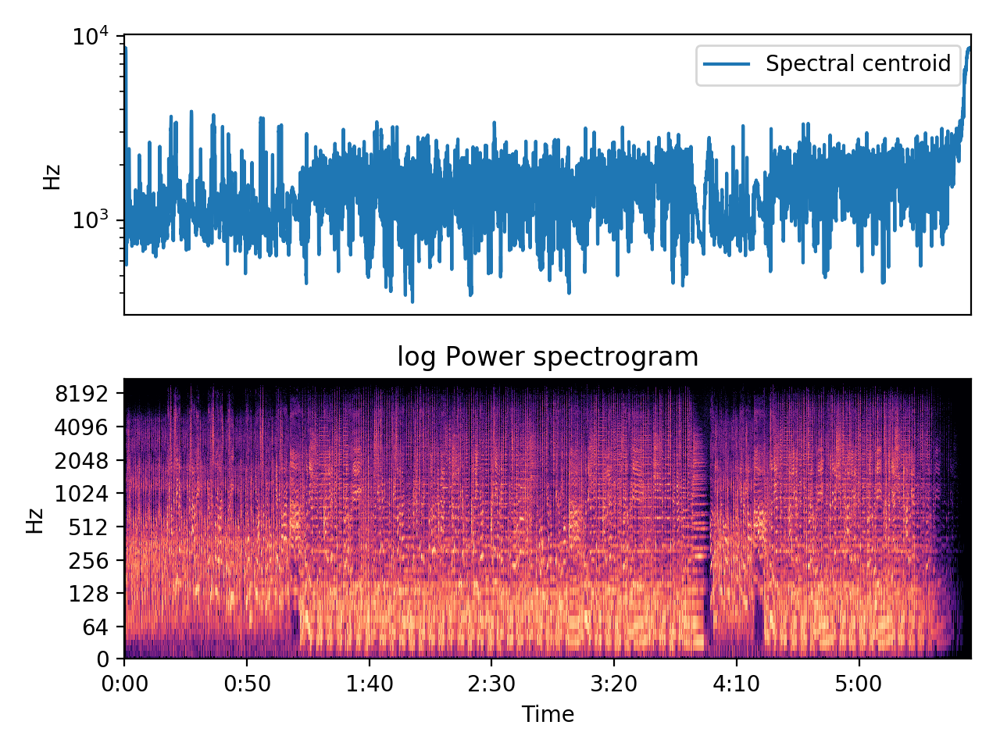

In [84]:
show_spectral_centroid(path_to_file1)

<IPython.core.display.Javascript object>


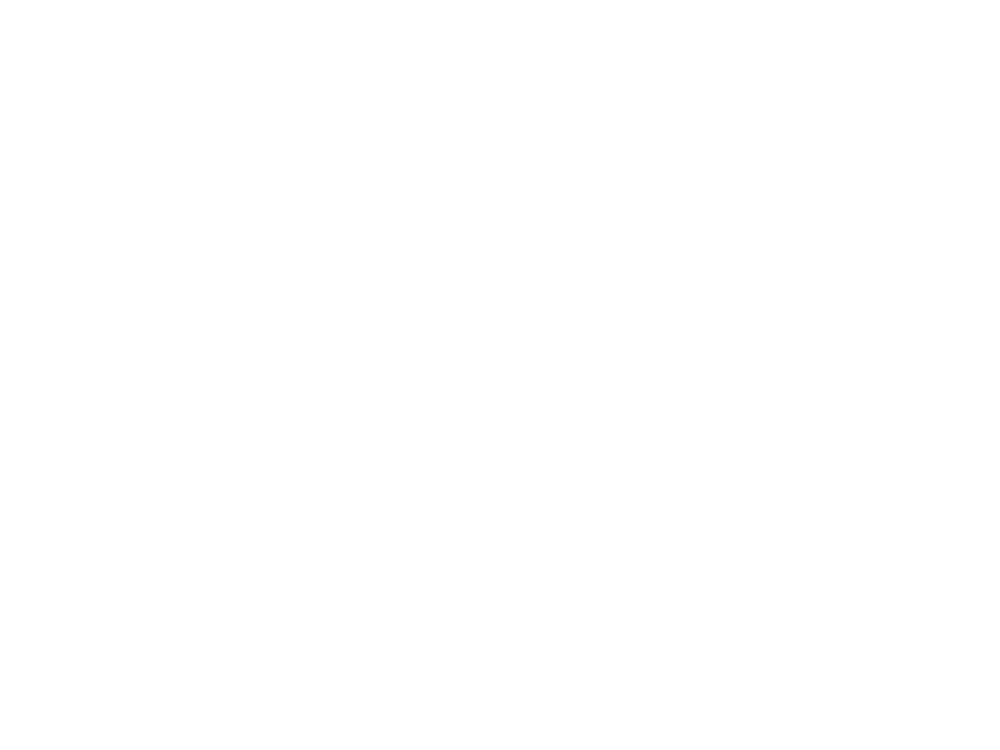

<IPython.core.display.Javascript object>


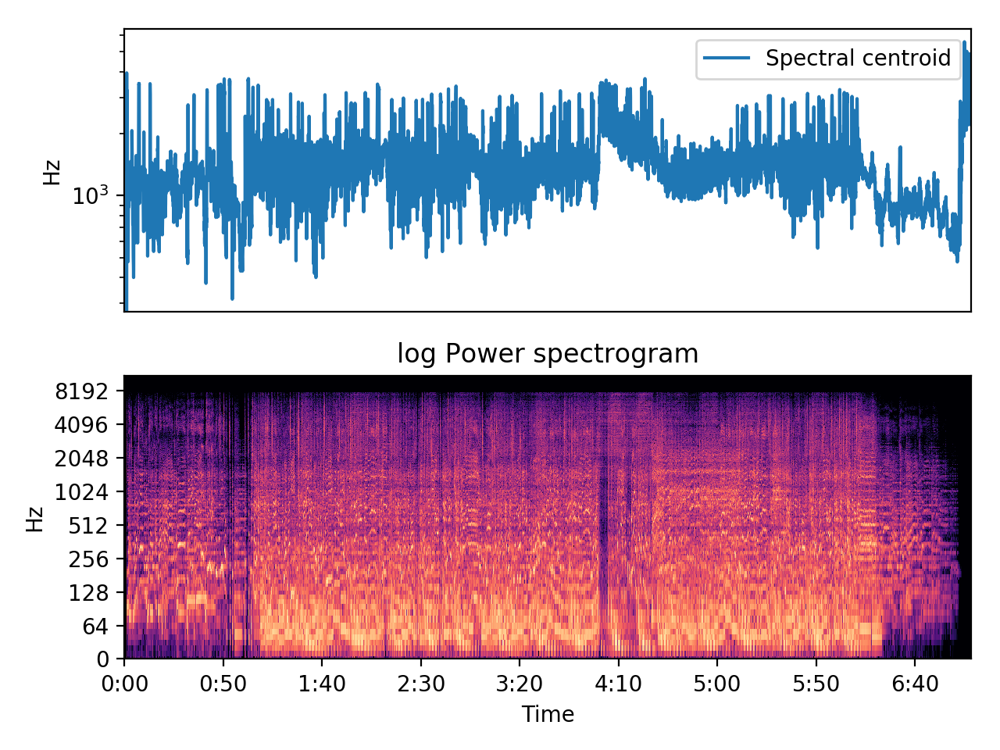

In [86]:
show_spectral_centroid(path_to_file2)

<IPython.core.display.Javascript object>


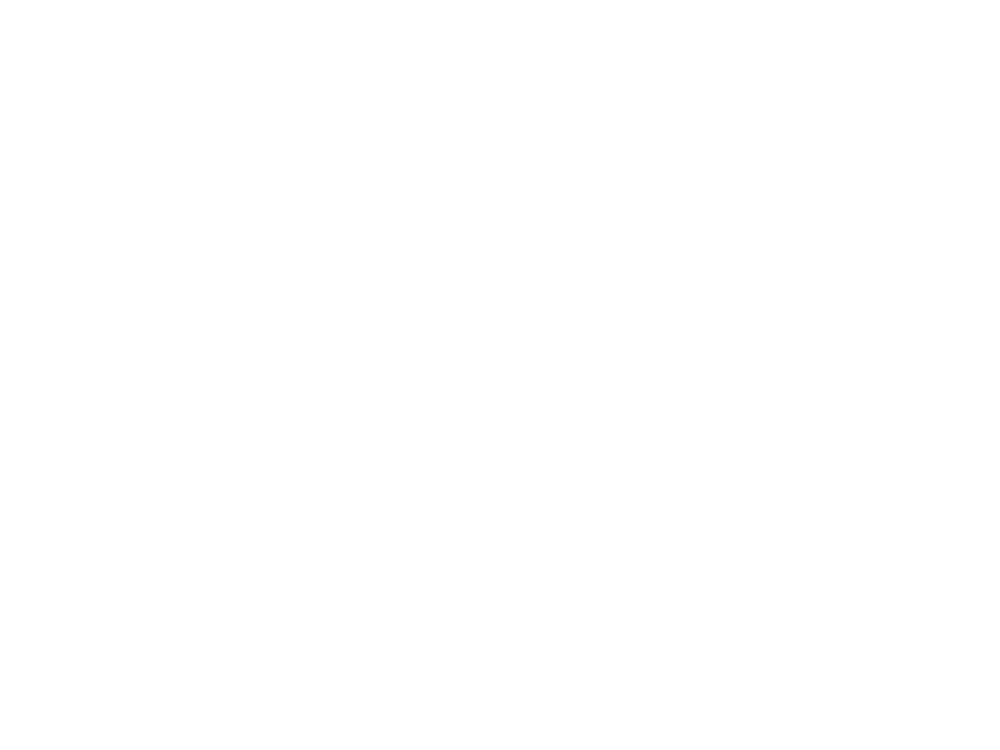

<IPython.core.display.Javascript object>


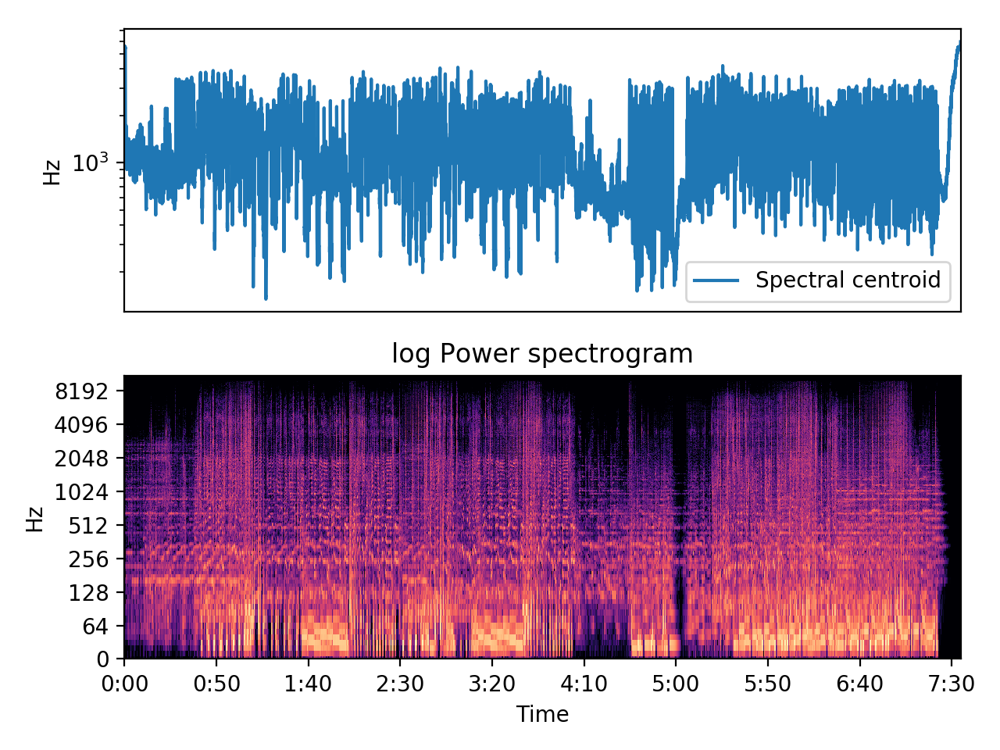

In [87]:
show_spectral_centroid(path_to_file3)

<IPython.core.display.Javascript object>


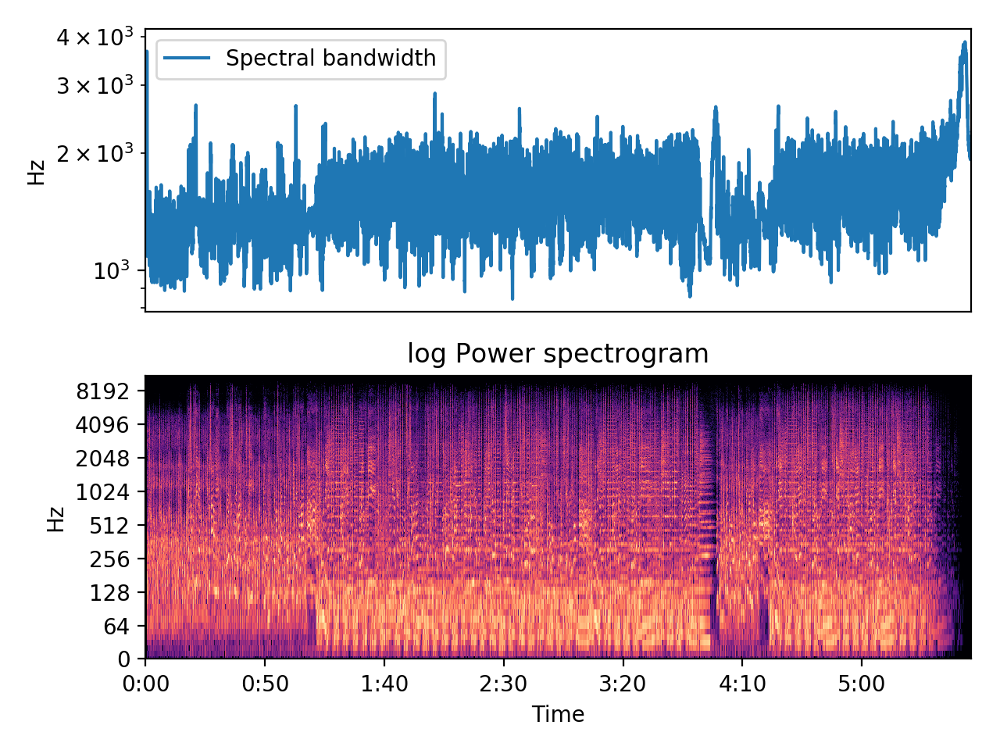

In [89]:
show_spectral_bandwidth(path_to_file1)

<IPython.core.display.Javascript object>


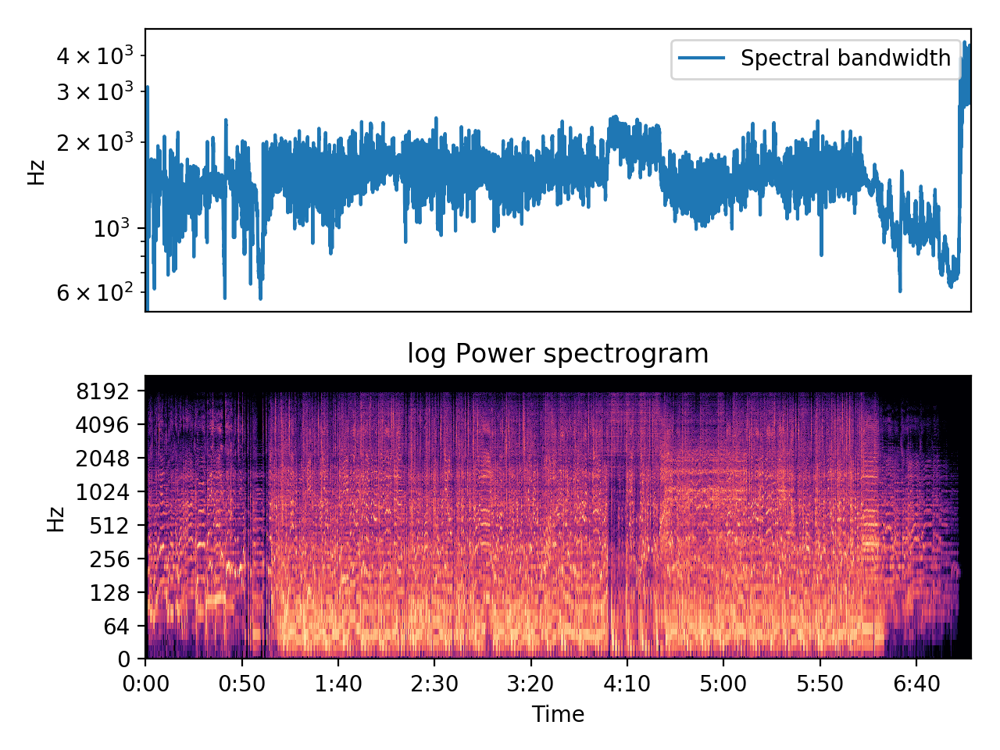

In [90]:
show_spectral_bandwidth(path_to_file2)

<IPython.core.display.Javascript object>


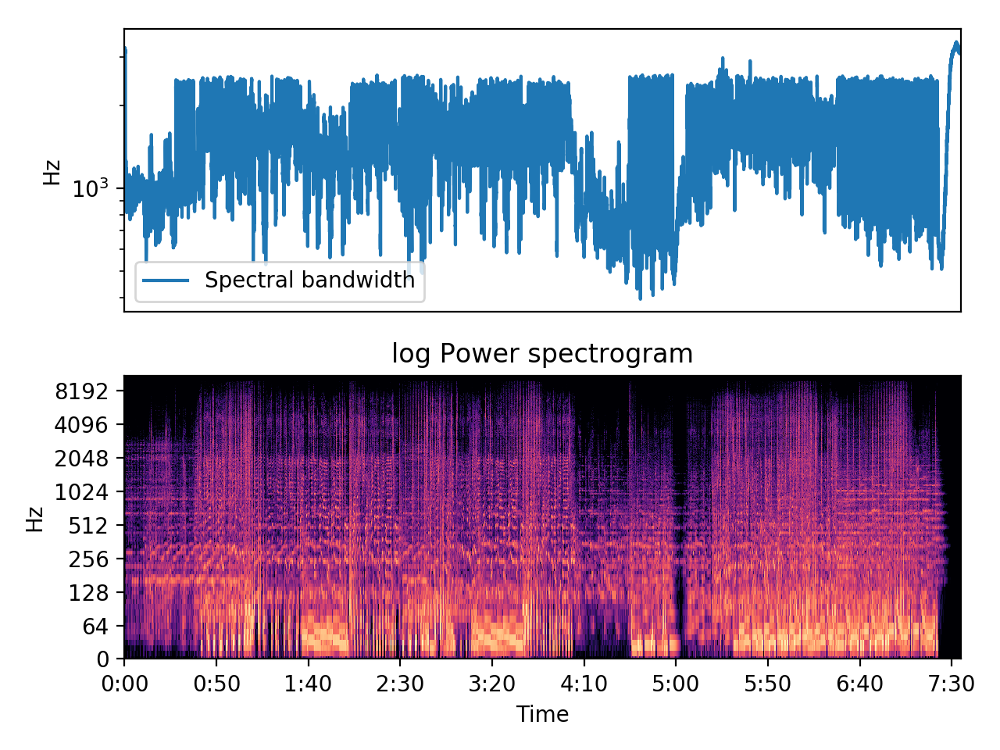

In [91]:
show_spectral_bandwidth(path_to_file3)

<IPython.core.display.Javascript object>


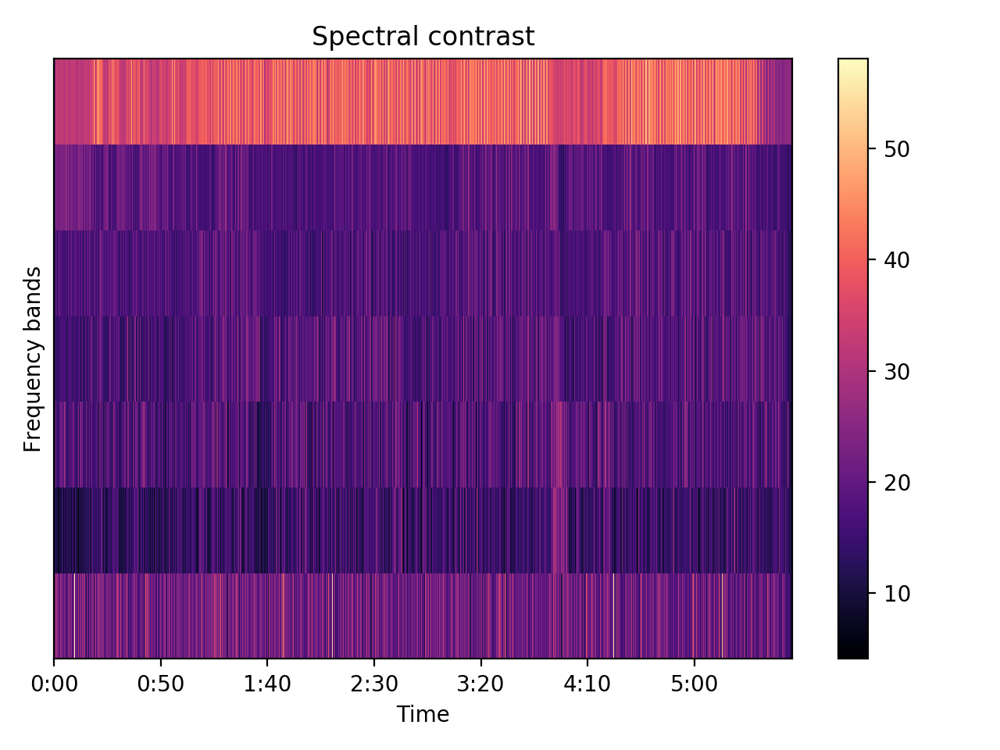

In [93]:
show_spectral_contrast(path_to_file1)

<IPython.core.display.Javascript object>


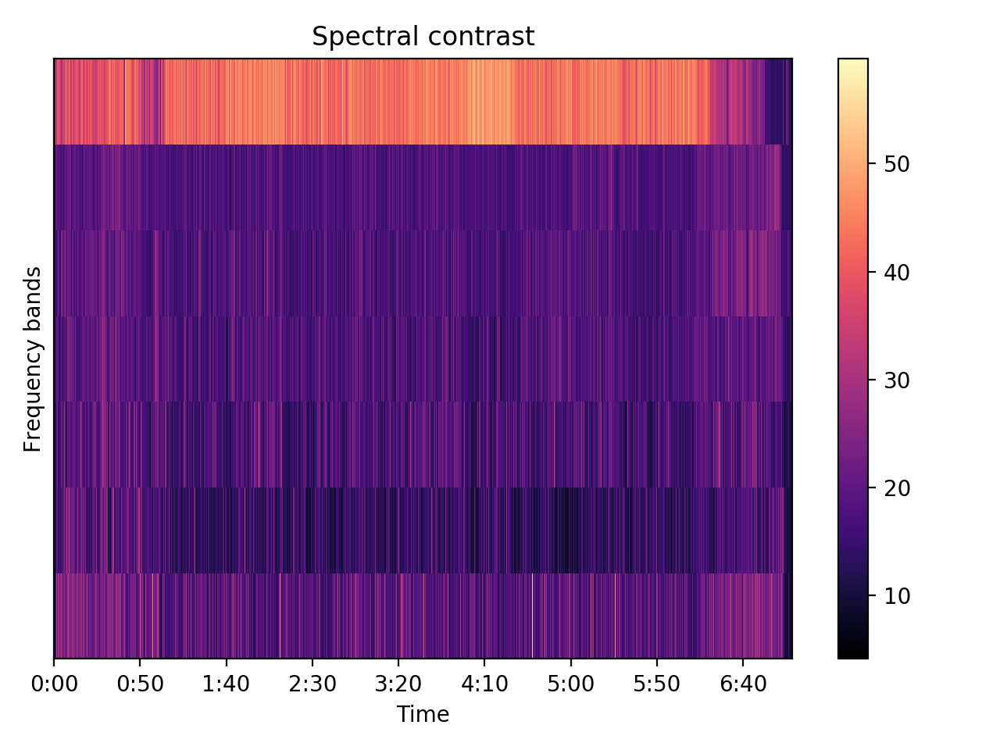

In [94]:
show_spectral_contrast(path_to_file2)

<IPython.core.display.Javascript object>


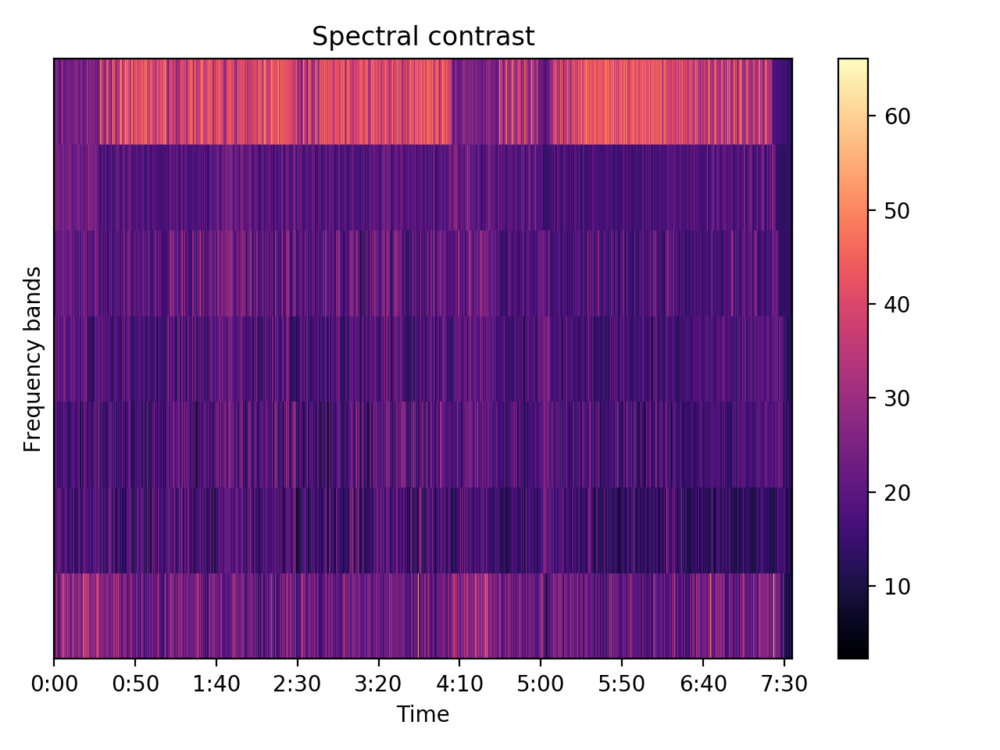

In [95]:
show_spectral_contrast(path_to_file3)

<IPython.core.display.Javascript object>


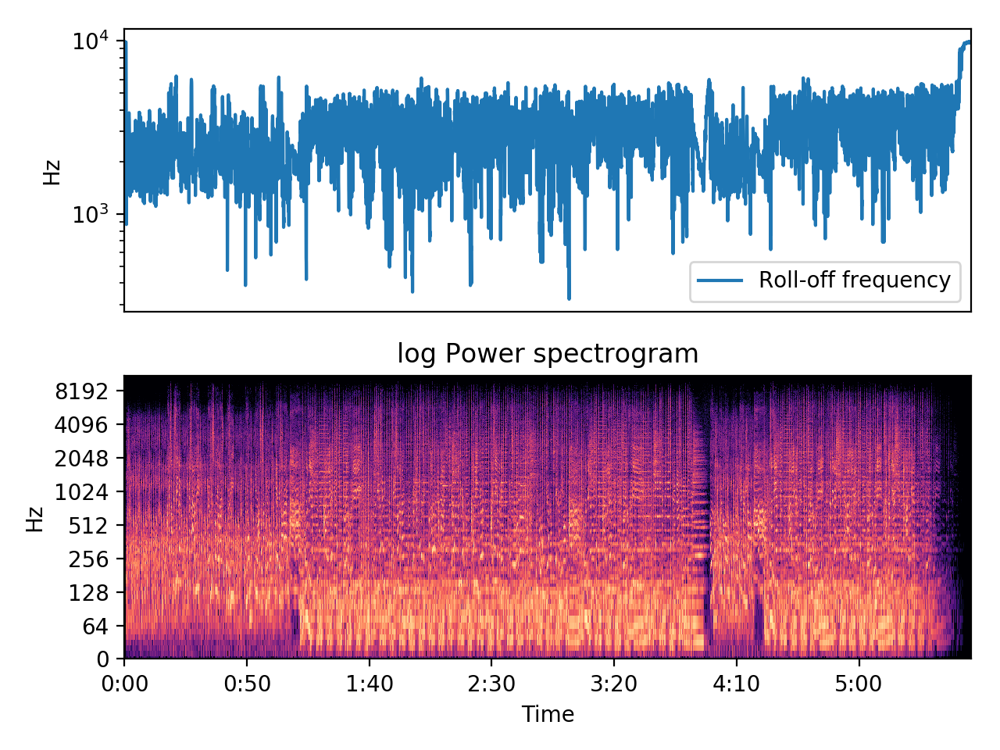

In [103]:
show_spectral_rollof(path_to_file1)

<IPython.core.display.Javascript object>


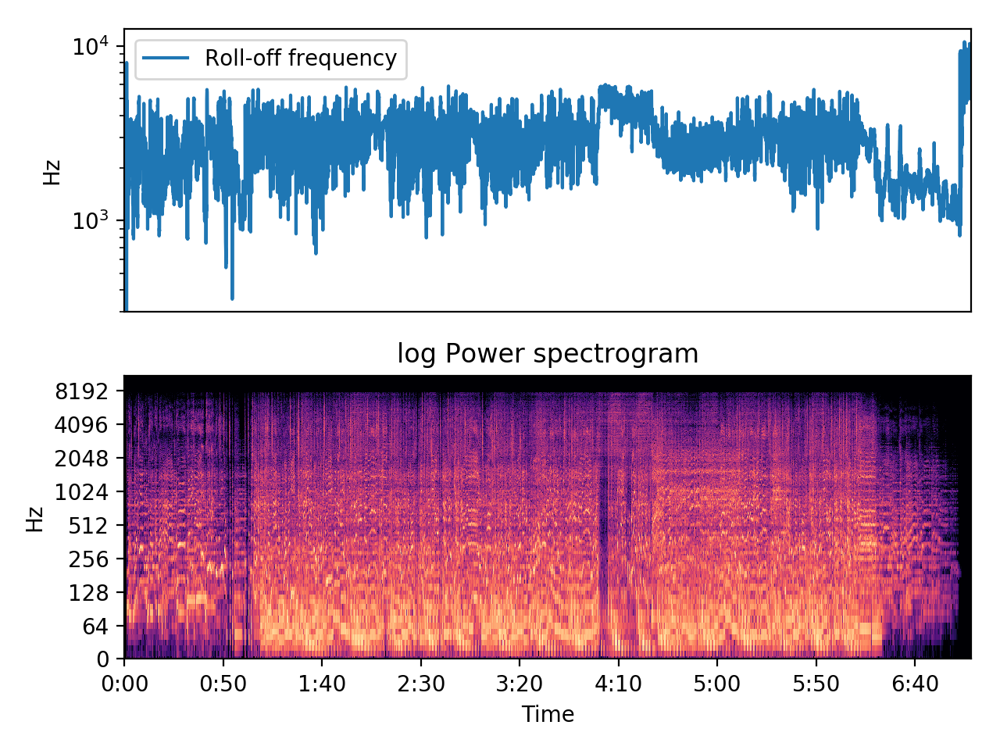

In [104]:
show_spectral_rollof(path_to_file2)

<IPython.core.display.Javascript object>


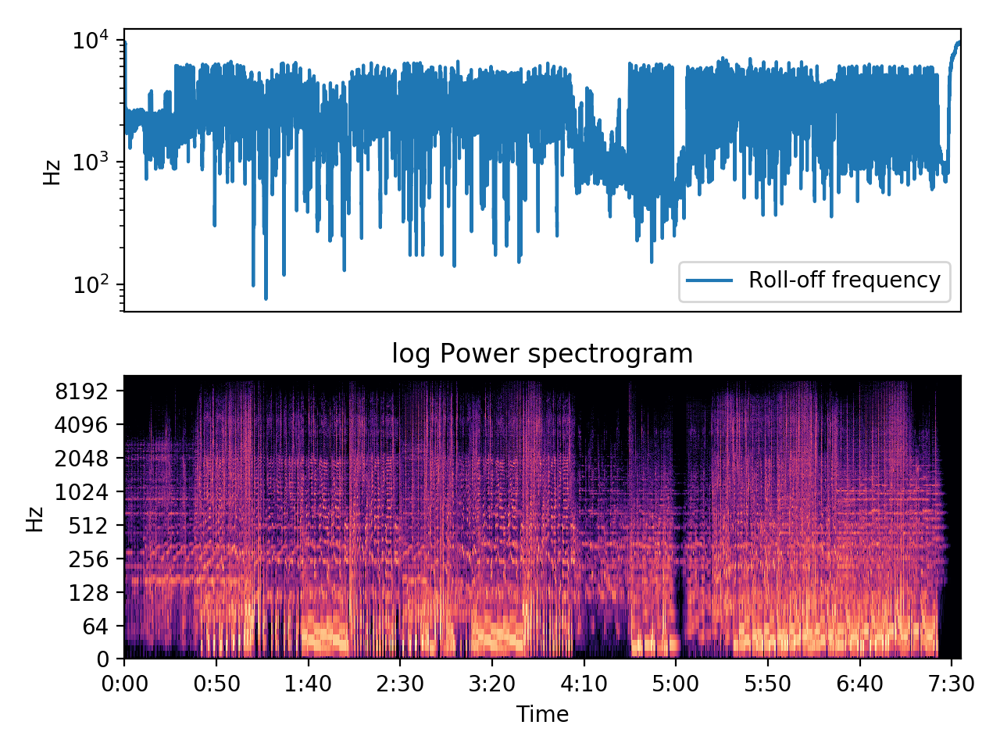

In [105]:
show_spectral_rollof(path_to_file3)

<IPython.core.display.Javascript object>


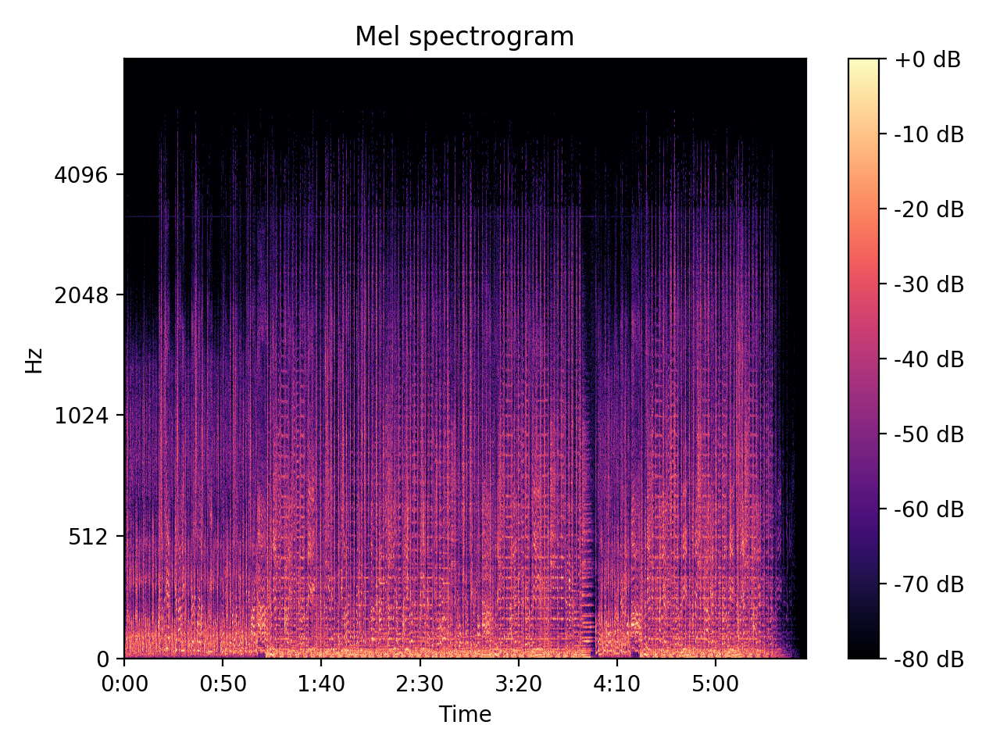

In [109]:
show_melspectogram(path_to_file1)

<IPython.core.display.Javascript object>


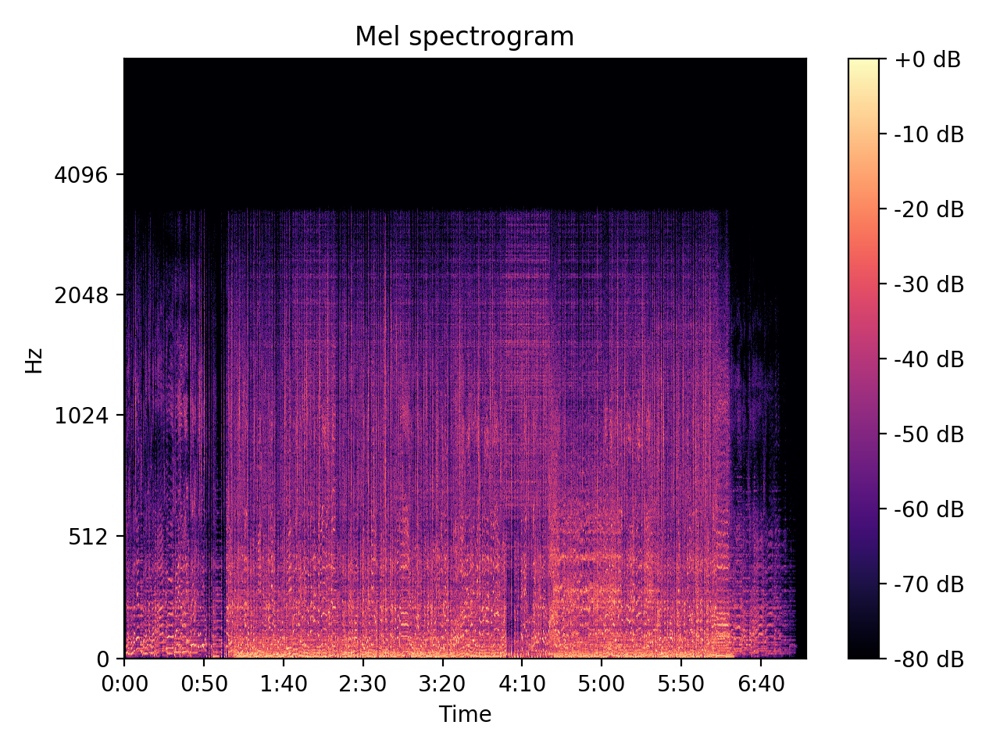

In [110]:
show_melspectogram(path_to_file2)

<IPython.core.display.Javascript object>


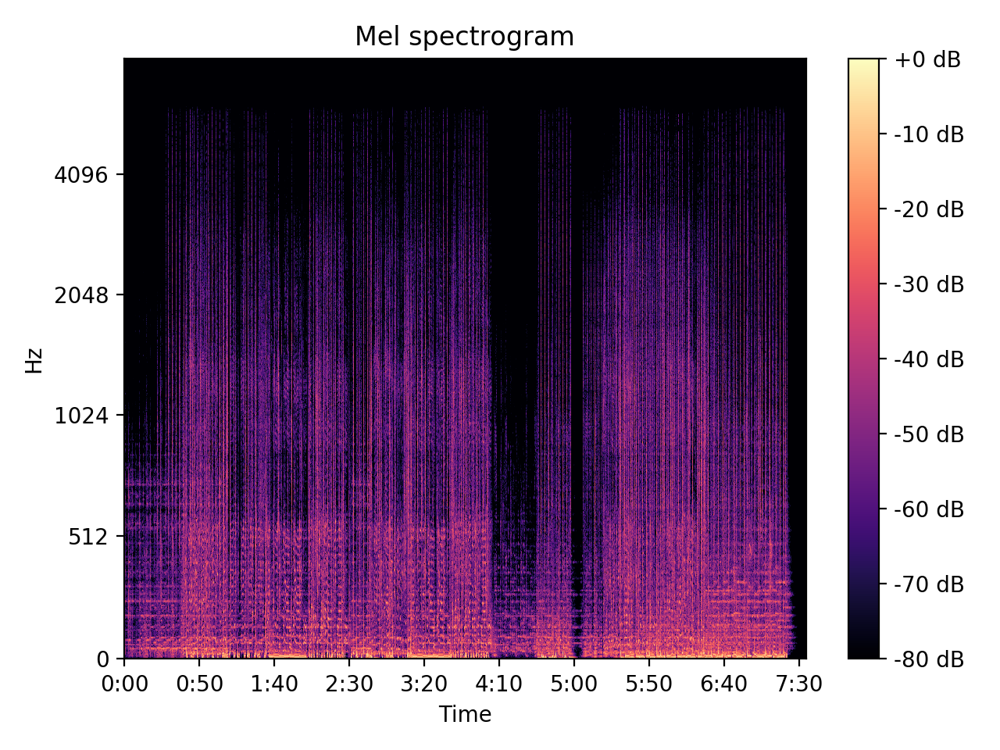

In [111]:
show_melspectogram(path_to_file3)

<IPython.core.display.Javascript object>


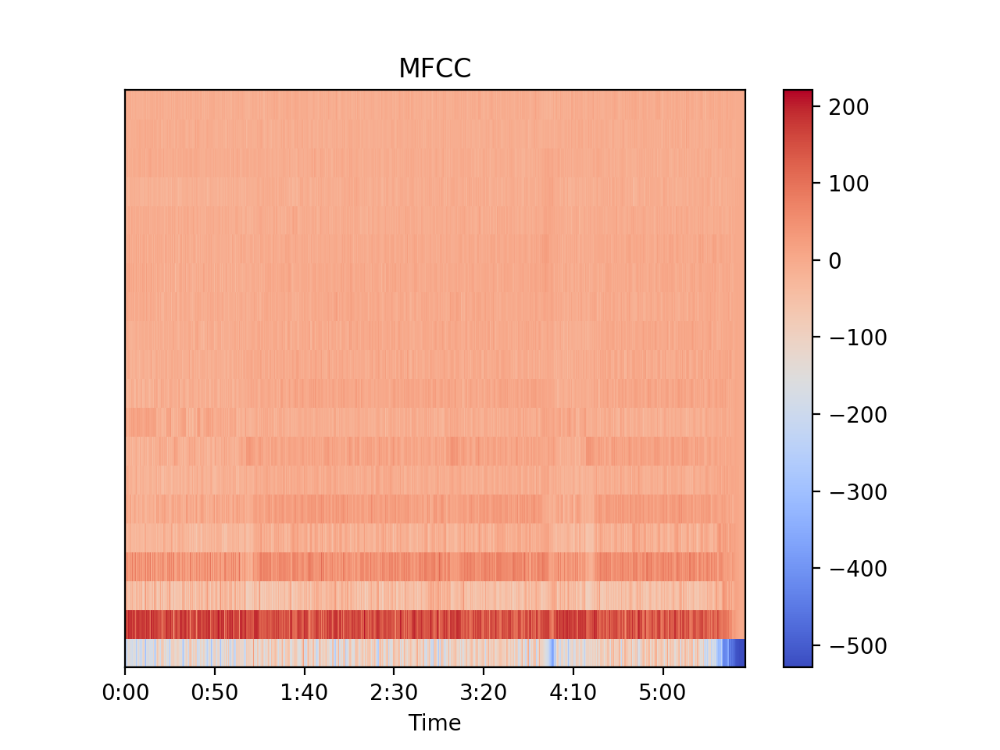

<IPython.core.display.Javascript object>


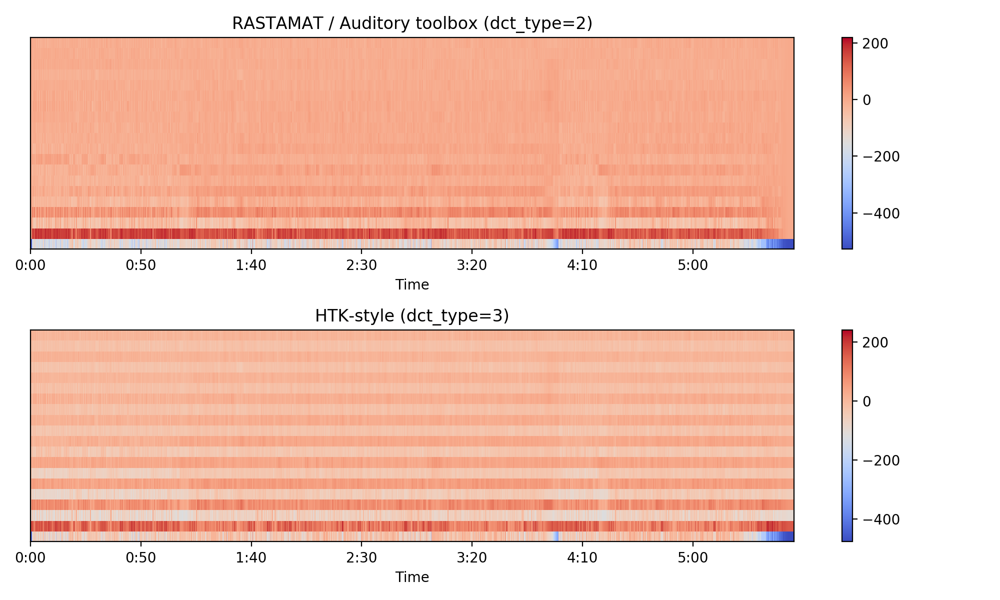

In [113]:
show_mfcc(path_to_file1)

<IPython.core.display.Javascript object>


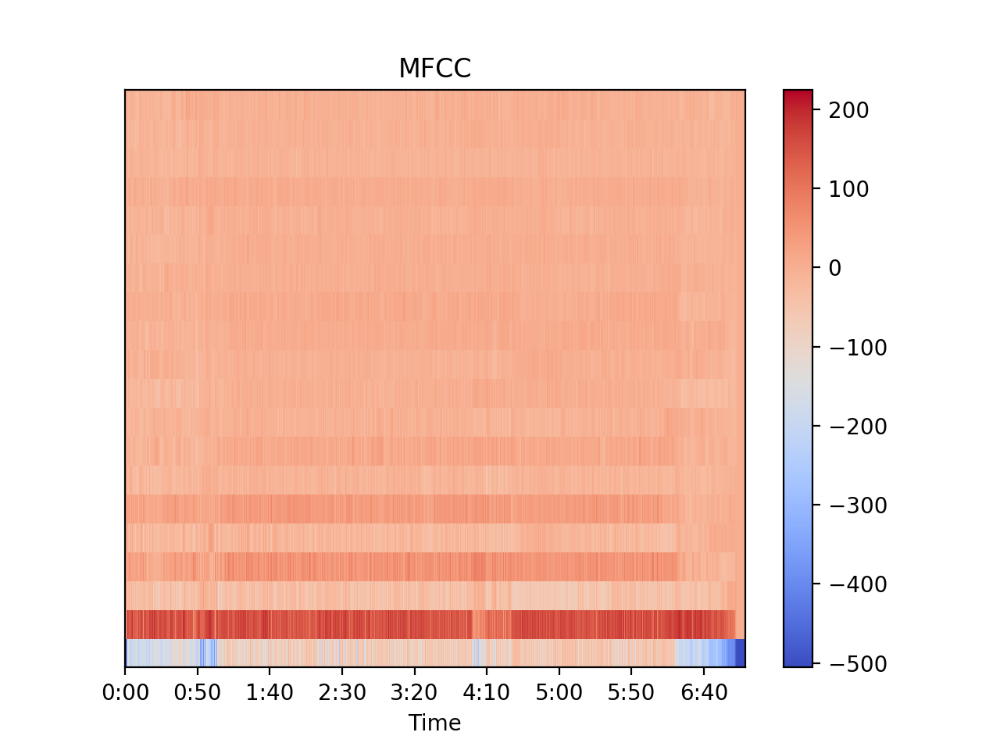

<IPython.core.display.Javascript object>


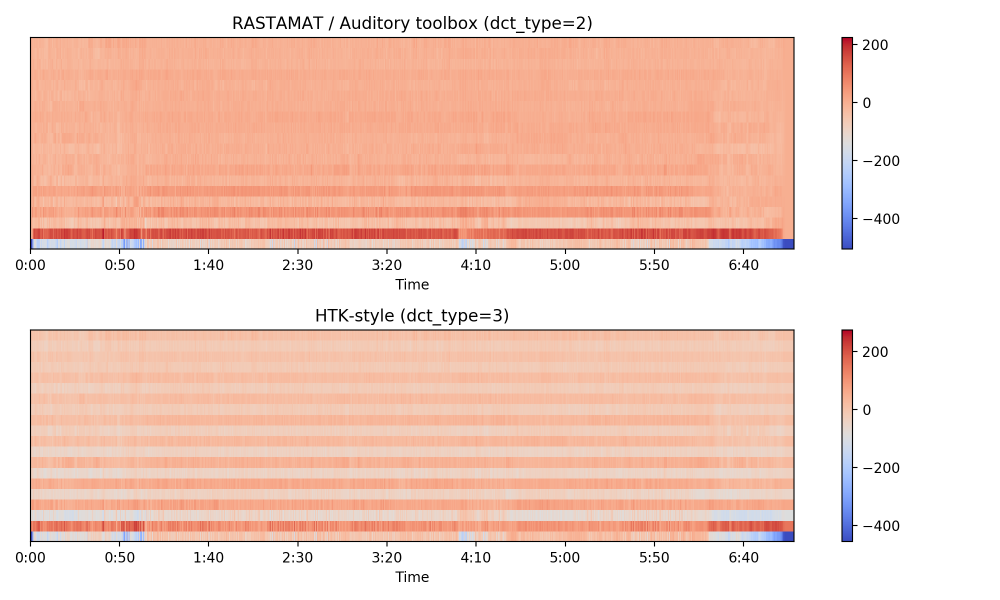

In [115]:
show_mfcc(path_to_file2)

<IPython.core.display.Javascript object>


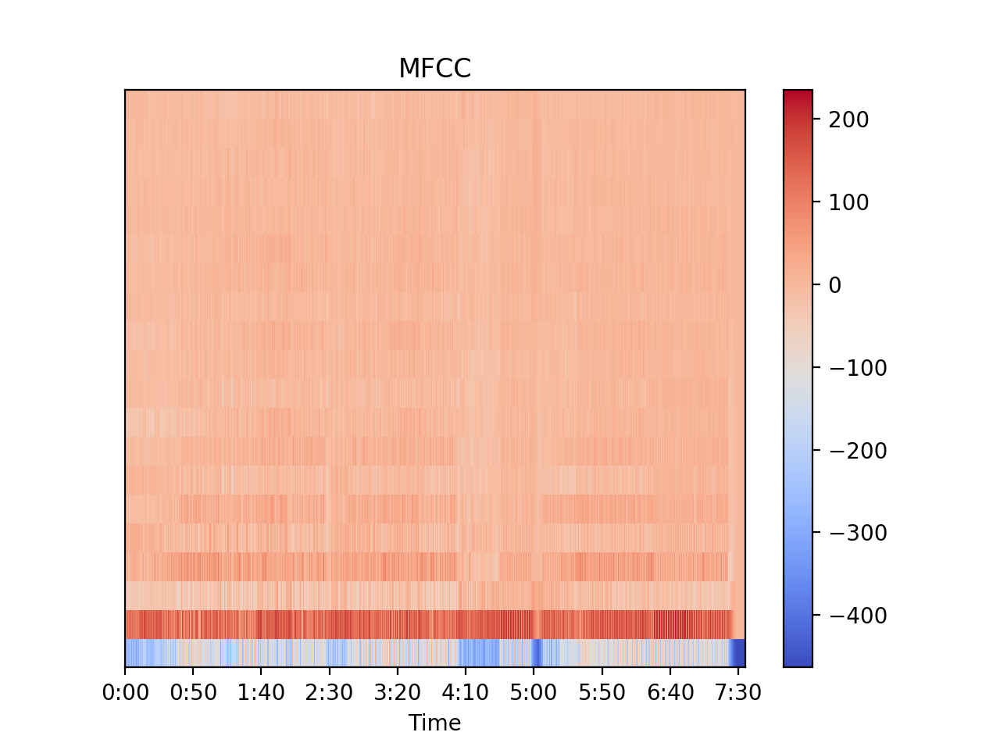

<IPython.core.display.Javascript object>


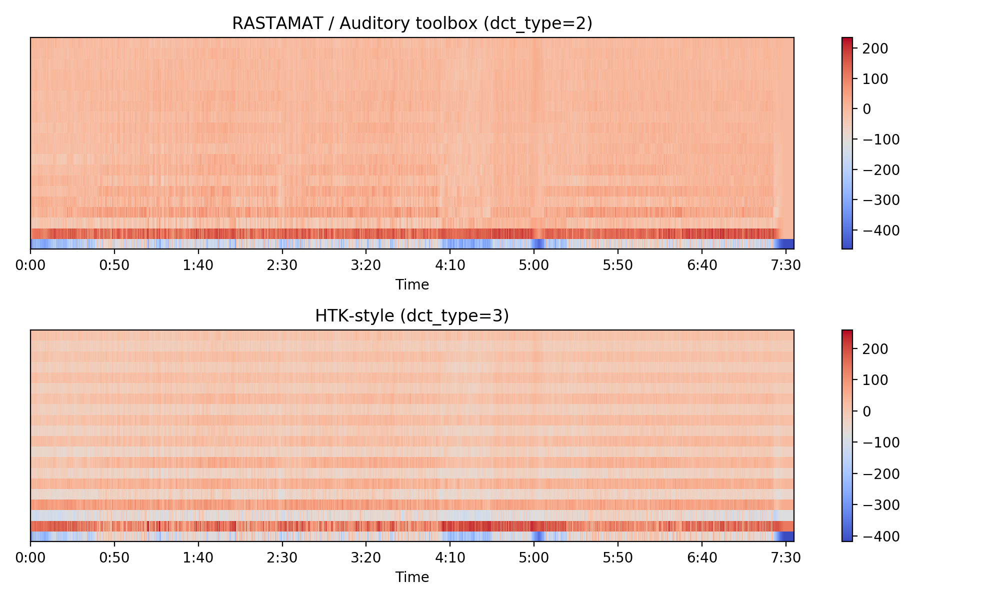

In [116]:
show_mfcc(path_to_file3)